In [1]:
# Imports

import os
from pathlib import Path
from rosbags.highlevel import AnyReader
from rosbags.image import message_to_cvimage
from rosbags.typesys import Stores, get_typestore
import numpy as np
import cv2
import matplotlib.pyplot as plt
import glob
import random
import matplotlib.image as mpimg
from IPython.display import display, Markdown


In [2]:
### Functions to extract images and poses from bag files *******************************

def extract_pose_from_bag(bags_root, bag_name, bag_path, task_output_root, pose_file_name):
    
    pose_output_path = os.path.join(task_output_root, pose_file_name)
    bagpath = Path(bag_path)
    typestore = get_typestore(Stores.ROS1_NOETIC)

    with AnyReader([bagpath], default_typestore=typestore) as reader, open(pose_output_path, 'w') as pose_output_file:
        # Write header
        header = "timestamp position.x position.y orientation.z\n"
        pose_output_file.write(header)

        # Find the connection for the topic
        connections = [x for x in reader.connections if x.topic == "/amcl_pose"]

        for connection, timestamp, rawdata in reader.messages(connections=connections):
            msg = reader.deserialize(rawdata, connection.msgtype)
            # Use attribute access instead of dictionary access
            t = int(timestamp / 1e9)  # nanoseconds to seconds
            pos = msg.pose.pose.position
            ori = msg.pose.pose.orientation
            line = f"{t} {pos.x:.5f} {pos.y:.5f} {ori.z:.5f}\n"
            pose_output_file.write(line)
    #print("Pose extraction completed.")

def extract_images_from_bag(bags_root, bag_name, bag_path, task_output_root):
    from pathlib import Path
    from rosbags.highlevel import AnyReader
    from rosbags.typesys import Stores, get_typestore

    bagpath = Path(bag_path)
    typestore = get_typestore(Stores.ROS1_NOETIC)

    topic_suffixes = {
        '/realsense_torso_front_camera/color/image_raw_throttle': '_t',
        '/realsense_front_camera/color/image_raw_throttle': '_f',
        '/realsense_left_camera/color/image_raw_throttle': '_l',
        '/realsense_right_camera/color/image_raw_throttle': '_r'
    }

    with AnyReader([bagpath], default_typestore=typestore) as reader:
        connections = [x for x in reader.connections if x.topic in topic_suffixes]
        for connection, timestamp, rawdata in reader.messages(connections=connections):
            msg = reader.deserialize(rawdata, connection.msgtype)
            # Convert ROS image message to OpenCV image
            img = message_to_cvimage(msg, 'bgr8')
            t = int(timestamp / 1e9)  # nanoseconds to seconds
            suffix = topic_suffixes[connection.topic]
            img_name = f"{t}{suffix}.jpg"
            img_output_path = os.path.join(task_output_root, img_name)
            cv2.imwrite(img_output_path, img)
    #print("Image extraction completed.")

In [3]:
### Functions to average poses to match camera frames **********************************

def avg_poses(dataset_root, pose_file_name, avg_pose_file_name):
    for dirpath, dirnames, filenames in os.walk(dataset_root):
        if pose_file_name in filenames:
            task_pose_file_path = os.path.join(dirpath, pose_file_name)
            task_avg_pose_file_path = os.path.join(dirpath, avg_pose_file_name)
            process_poses_file(task_pose_file_path, task_avg_pose_file_path)
            
def process_poses_file(task_pose_file_path, task_avg_pose_file_path):
    # Dictionary: timestamp -> list of [x, y, z]
    poses_dict = {}
    with open(task_pose_file_path, 'r') as f:
        header = f.readline()
        for line in f:
            tokens = line.strip().split()
            if len(tokens) < 4:
                continue
            timestamp = tokens[0]
            values = [float(tokens[1]), float(tokens[2]), float(tokens[3])]
            poses_dict.setdefault(timestamp, []).append(values)
    # Calculate averages and write to output
    with open(task_avg_pose_file_path, 'w') as f:
        f.write("timestamp position.x position.y orientation.z\n")
        for timestamp in sorted(poses_dict.keys()):
            arr = np.array(poses_dict[timestamp])
            avg = arr.mean(axis=0)
            f.write(f"{timestamp} {avg[0]:.5f} {avg[1]:.5f} {avg[2]:.5f}\n")

In [4]:
### Functions to plot poses **************************************************************

def read_poses_avg(file_path):
    xs, ys, zs = [], [], []
    with open(file_path, 'r') as f:
        header = f.readline()
        for line in f:
            tokens = line.strip().split()
            if len(tokens) < 4:
                continue
            xs.append(float(tokens[1]))
            ys.append(float(tokens[2]))
            zs.append(float(tokens[3]))
    return np.array(xs), np.array(ys), np.array(zs)

def plot_orientations(xs, ys, zs, color, label, scale=0.5):
    plt.plot(xs, ys, marker='o', color=color, label=label)
    for x, y, z in zip(xs, ys, zs):
        dx = scale * np.cos(z)
        dy = scale * np.sin(z)
        plt.arrow(x, y, dx, dy, head_width=0.1, head_length=0.1, fc=color, ec=color, alpha=0.6)

def plot_poses(dataset_root, avg_pose_file_name, fig_width=48, fig_height=36, dpi=200):
    plt.figure(figsize=(fig_width, fig_height))
    color_cycle = plt.rcParams['axes.prop_cycle'].by_key()['color']
    color_idx = 0

    for dirpath, dirnames, filenames in os.walk(dataset_root):
        if "poses_avg.txt" in filenames:
            file_path = os.path.join(dirpath, "poses_avg.txt")
            xs, ys, zs = read_poses_avg(file_path)
            label = os.path.relpath(dirpath, dataset_root)
            color = color_cycle[color_idx % len(color_cycle)]
            plot_orientations(xs, ys, zs, color, label)
            color_idx += 1

    plt.xlabel("Position X")
    plt.ylabel("Position Y")
    plt.title("Overlayed Average Poses from All Folders")
    #plt.legend()
    plt.axis('equal')
    plt.grid(True)
    plt.tight_layout()
    plt.show()
    plt.close()

In [5]:
### Functions to output image pose pairs *************************************************

def parse_poses_file(poses_path):
    poses = {}
    with open(poses_path, "r") as f:
        header = f.readline()
        for line in f:
            tokens = line.strip().split()
            if len(tokens) < 4:
                continue
            timestamp = tokens[0]
            position = [float(tokens[1]), float(tokens[2]), float(tokens[3])]
            poses[timestamp] = position
    return poses

def timestamp_from_filename(filename):
    base = os.path.basename(filename)
    return base.split('_')[0]

def collect_images_and_poses(dataset_root, avg_pose_file_name, image_pose_path):
    rows = []
    for dirpath, dirnames, filenames in os.walk(dataset_root):
        if avg_pose_file_name in filenames:
            poses_path = os.path.join(dirpath, avg_pose_file_name)
            poses = parse_poses_file(poses_path)
            images = glob.glob(os.path.join(dirpath, "*.jpg"))
            for img in images:
                ts = timestamp_from_filename(img)
                if ts in poses:
                    rel_img_path = os.path.relpath(img, dataset_root)
                    x, y, theta = poses[ts]
                    rows.append(f"{rel_img_path} {x} {y} {theta}")
                    
    with open(image_pose_path, "w") as f:
        for row in rows:
            f.write(row + "\n")

In [16]:
### Functions to filter images based on their brightness *********************************

def compute_brightness(image_path):
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        return None
    return img.mean()
    
def is_valid_image(image_path, min_brightness, max_brightness):
    if not os.path.exists(image_path):
        return False
    img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        return False
    mean_brightness = img.mean()
    return min_brightness <= mean_brightness <= max_brightness
    
def filter_images(dataset_root, image_pose_path, filtered_image_pose_path, min_brightness, max_brightness, image_col_index=0, delimiter=' '):
    with open(image_pose_path, 'r') as infile, open(filtered_image_pose_path, 'w') as outfile:
        for line in infile:
            parts = line.strip().split(delimiter)
            if len(parts) <= image_col_index:
                continue
            rel_path = parts[image_col_index]
            full_path = os.path.join(dataset_root, rel_path)
            if is_valid_image(full_path, min_brightness, max_brightness):
                outfile.write(line)

def plot_brightness(dataset_root, image_pose_path, image_col_index=0, delimiter=' '):
    brightness_values = []
    with open(image_pose_path, 'r') as file:
        for line in file:
            parts = line.strip().split(delimiter)
            if len(parts) <= image_col_index:
                continue

            rel_path = parts[image_col_index]
            full_path = os.path.join(dataset_root, rel_path)
            if not os.path.exists(full_path):
                continue

            brightness = compute_brightness(full_path)
            if brightness is not None:
                brightness_values.append(brightness)
                
    plt.hist(brightness_values, bins=50, color='skyblue', edgecolor='black')
    plt.title("Image Brightness Distribution")
    plt.xlabel("Mean Brightness (0 = dark, 255 = bright)")
    plt.ylabel("Number of Images")
    plt.grid(True)
    plt.show()  
    return brightness_values

def count_suffixes(file_path):
    suffix_map = {
        '_t': 'Torso',
        '_f': 'Front',
        '_r': 'Right',
        '_l': 'Left'
    }
    counts = {group: 0 for group in suffix_map.values()}
    row_count = 0  # Initialize row counter
    
    with open(file_path, 'r') as f:
        for line in f:
            columns = line.strip().split()
            if not columns:
                continue
            row_count += 1  # Increment for each non-empty row
            image_path = columns[0]
            filename = os.path.basename(image_path)
            name, ext = os.path.splitext(filename)
            for suf, group in suffix_map.items():
                if name.endswith(suf):
                    counts[group] += 1
                    break
    return counts, row_count

def plot_pie(counts):
    labels = []
    sizes = []
    for k, v in counts.items():
        if v > 0:
            labels.append(k)
            sizes.append(v)
    if not sizes:
        print("No images with the expected suffixes were found. Nothing to plot.")
        return
    plt.figure(figsize=(3, 3))
    plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=140)
    plt.title('Distribution of Camera Samples')
    plt.axis('equal')
    plt.show()

In [7]:
### Functions to create the ground truth *************************************************

def read_pose_file(pose_file_path):
    all_images = []
    with open(pose_file_path, "r") as f:
        for line in f:
            tokens = line.strip().split()
            if len(tokens) < 4:
                continue
            img_path = tokens[0]
            x, y = float(tokens[1]), float(tokens[2])
            ts = tokens[3]
            all_images.append({
                "path": img_path,
                "position": np.array([x, y]),
                "timestamp": ts
            })
    return all_images

def get_suffix(filename):
    """Extracts the suffix (e.g., '_t', '_r', '_f', '_l') from the filename before the extension."""
    base = os.path.splitext(os.path.basename(filename))[0]
    # Assumes the suffix is the last two characters (e.g., '_t')
    return base[-2:]
    
def get_folder(path):
    # Returns the immediate parent directory name
    return os.path.normpath(path).split(os.sep)[0]

def mine_triplets_other_folders_with_suffix(all_images, POSITIVE_DISTANCE_THRESHOLD, NEGATIVE_DISTANCE_THRESHOLD):
    # Precompute arrays for fast indexing
    positions = np.array([img["position"] for img in all_images])
    paths = np.array([img["path"] for img in all_images])
    suffixes = np.array([get_suffix(p) for p in paths])
    folders = np.array([get_folder(p) for p in paths])

    triplets = []

    # For each unique (suffix), group indices to reduce comparisons
    for suffix in np.unique(suffixes):
        idx_with_suffix = np.where(suffixes == suffix)[0]
        # For each unique folder in this suffix group
        for anchor_folder in np.unique(folders[idx_with_suffix]):
            anchor_idx = idx_with_suffix[folders[idx_with_suffix] == anchor_folder]
            # Candidates: same suffix, different folder
            candidate_idx = idx_with_suffix[folders[idx_with_suffix] != anchor_folder]
            if len(candidate_idx) == 0 or len(anchor_idx) == 0:
                continue
            # Precompute candidate positions
            candidate_positions = positions[candidate_idx]
            candidate_paths = paths[candidate_idx]
            candidate_folders = folders[candidate_idx]
            # For each anchor in this group
            for i in anchor_idx:
                anchor_pos = positions[i]
                anchor_path = paths[i]
                # Compute distances to all candidates in one go
                dists = np.linalg.norm(candidate_positions - anchor_pos, axis=1)
                # Mask for positives and negatives
                pos_mask = (dists > 0) & (dists <= POSITIVE_DISTANCE_THRESHOLD)
                neg_mask = (dists >= NEGATIVE_DISTANCE_THRESHOLD)
                pos_candidates = candidate_paths[pos_mask]
                neg_candidates = candidate_paths[neg_mask]
                if len(pos_candidates) > 0 and len(neg_candidates) > 0:
                    pos_path = np.random.choice(pos_candidates)
                    neg_path = np.random.choice(neg_candidates)
                    triplets.append((anchor_path, pos_path, neg_path))
    return triplets

def mine_triplets_other_folders_with_suffix_old(all_images):
    triplets = []
    positions = np.array([img["position"] for img in all_images])
    paths = [img["path"] for img in all_images]
    suffixes = [get_suffix(p) for p in paths]
    folders = [get_folder(p) for p in paths]
    for idx, anchor in enumerate(all_images):
        anchor_pos = anchor["position"]
        anchor_path = anchor["path"]
        anchor_suffix = get_suffix(anchor_path)
        anchor_folder = get_folder(anchor_path)
        dists = np.linalg.norm(positions - anchor_pos, axis=1)
        # Only select candidates from different folders and with the same suffix
        positive_candidates = [
            p for i, (d, p, s, f) in enumerate(zip(dists, paths, suffixes, folders))
            if 0 < d <= POSITIVE_DISTANCE_THRESHOLD and p != anchor_path and s == anchor_suffix and f != anchor_folder
        ]
        negative_candidates = [
            p for i, (d, p, s, f) in enumerate(zip(dists, paths, suffixes, folders))
            if d >= NEGATIVE_DISTANCE_THRESHOLD and p != anchor_path and s == anchor_suffix and f != anchor_folder
        ]
        if positive_candidates and negative_candidates:
            pos_path = random.choice(positive_candidates)
            neg_path = random.choice(negative_candidates)
            triplets.append((anchor_path, pos_path, neg_path))
    return triplets
    
def mine_triplets_with_suffix(all_images):
    triplets = []
    positions = np.array([img["position"] for img in all_images])
    paths = [img["path"] for img in all_images]
    suffixes = [get_suffix(p) for p in paths]
    for idx, anchor in enumerate(all_images):
        anchor_pos = anchor["position"]
        anchor_path = anchor["path"]
        anchor_suffix = get_suffix(anchor_path)
        dists = np.linalg.norm(positions - anchor_pos, axis=1)
        # Filter candidates to only those with the same suffix as anchor
        positive_candidates = [
            p for i, (d, p, s) in enumerate(zip(dists, paths, suffixes))
            if 0 < d <= POSITIVE_DISTANCE_THRESHOLD and p != anchor_path and s == anchor_suffix
        ]
        negative_candidates = [
            p for i, (d, p, s) in enumerate(zip(dists, paths, suffixes))
            if d >= NEGATIVE_DISTANCE_THRESHOLD and p != anchor_path and s == anchor_suffix
        ]
        if positive_candidates and negative_candidates:
            pos_path = random.choice(positive_candidates)
            neg_path = random.choice(negative_candidates)
            triplets.append((anchor_path, pos_path, neg_path))
    return triplets
    
def mine_triplets(all_images):
    triplets = []
    positions = np.array([img["position"] for img in all_images])
    paths = [img["path"] for img in all_images]
    for idx, anchor in enumerate(all_images):
        anchor_pos = anchor["position"]
        anchor_path = anchor["path"]
        dists = np.linalg.norm(positions - anchor_pos, axis=1)
        positive_candidates = [
            p for i, (d, p) in enumerate(zip(dists, paths))
            if 0 < d <= POSITIVE_DISTANCE_THRESHOLD and p != anchor_path
        ]
        negative_candidates = [
            p for i, (d, p) in enumerate(zip(dists, paths))
            if d >= NEGATIVE_DISTANCE_THRESHOLD and p != anchor_path
        ]
        if positive_candidates and negative_candidates:
            pos_path = random.choice(positive_candidates)
            neg_path = random.choice(negative_candidates)
            triplets.append((anchor_path, pos_path, neg_path))
    return triplets

In [8]:
### Adjust the params ********************************************************************

bags_root = '/home/jovyan/data/VPR/LW_bags/All'
dataset_root = '/home/jovyan/data/VPR/LW'

pose_file_name = "poses.txt"
avg_pose_file_name = "poses_avg.txt"

image_pose_path = os.path.join(dataset_root, "image_pose.txt")
filtered_image_pose_path = os.path.join(dataset_root, "filtered_image_pose.txt")
gt_path = os.path.join(dataset_root, "gt.txt")

POSITIVE_DISTANCE_THRESHOLD = 0.5
NEGATIVE_DISTANCE_THRESHOLD = 10.0

In [9]:
### Set the params first *****************************************************************

### Bag extraction ***********************************************************************
for bag_name in os.listdir(bags_root):
    if bag_name.endswith('.bag'):
        bag_name_noext, ext = os.path.splitext(bag_name)
        short_bag_name = bag_name_noext[:41]
        bag_path = os.path.join(bags_root, bag_name)
        # print(f"Processing {bag_path}")
        task_output_root = os.path.join(dataset_root, short_bag_name)
        os.makedirs(task_output_root, exist_ok=True)
        extract_images_from_bag(bags_root, bag_name, bag_path, task_output_root)
        extract_pose_from_bag(bags_root, bag_name, bag_path, task_output_root, pose_file_name)
    
print("Finished bag file extraction")

Finished bag file extraction


In [10]:
### Pose average *************************************************************************
avg_poses(dataset_root, pose_file_name, avg_pose_file_name)
print("Finished pose averaging")

Finished pose averaging


In [11]:
### Plot poses ***************************************************************************
#plot_poses(dataset_root, avg_pose_file_name)
#print("Finished pose plotting")

In [12]:
### Output image_pose file ***************************************************************
collect_images_and_poses(dataset_root, avg_pose_file_name, image_pose_path)
print("Finished image pose pairing")

Finished image pose pairing


Before filtering: 136,033


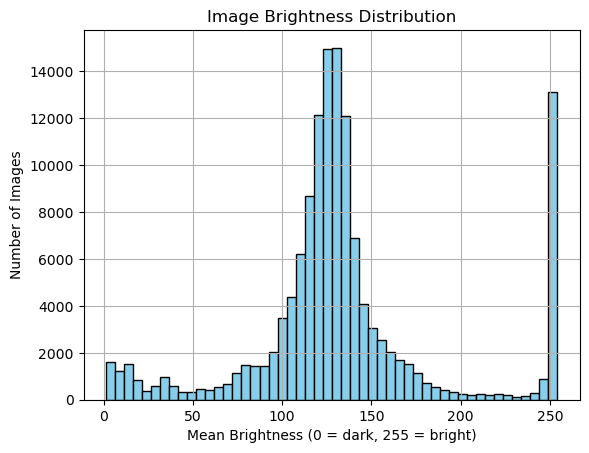

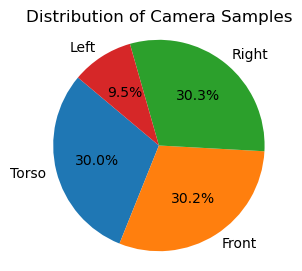

Filtering in progress
Finished image filtering
After filtering: 116,107


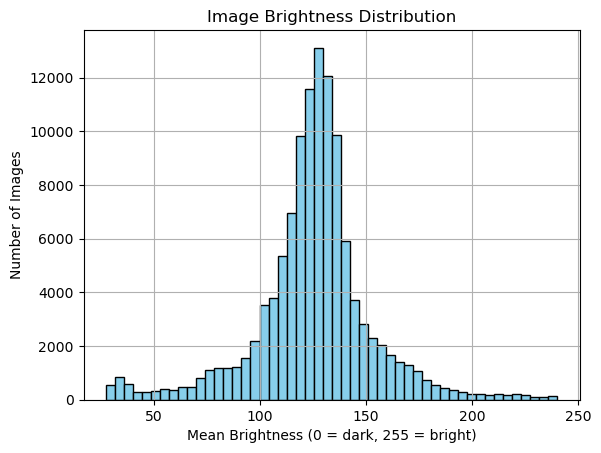

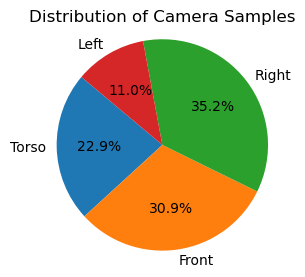

In [18]:
### Image filter *************************************************************************

counts, row_count = count_suffixes(image_pose_path)
print("Before filtering: {:,}".format(row_count))
brightness_values = plot_brightness(dataset_root, image_pose_path)
plot_pie(counts)

brightness_mean = np.mean(brightness_values) 
brightness_std = np.std(brightness_values)

# First option using mean and std
min_brightness = brightness_mean-2*brightness_std
max_brightness = brightness_mean+2*brightness_std

# Second option using percentile is more robust to outliers 
# This keeps 96% of the images and trims 2% from each tail 
#min_brightness = np.percentile(brightness_values, 2)
#max_brightness = np.percentile(brightness_values, 98)

print("Filtering in progress")
filter_images(dataset_root, image_pose_path, filtered_image_pose_path, min_brightness, max_brightness)
print("Finished image filtering")

counts, row_count = count_suffixes(filtered_image_pose_path)
print("After filtering: {:,}".format(row_count))
plot_brightness(dataset_root, filtered_image_pose_path)
plot_pie(counts)

In [14]:
### Ground truth generation **************************************************************
all_images = read_pose_file(filtered_image_pose_path)

# Multiple options are available to control the ground truth generation

# First option is to do task selection and camera selection by random
#triplets = mine_triplets(all_images)

# Second option is to use same camera to find positive and negative cases
#triplets = mine_triplets_with_suffix(all_images)

# Third option is to use same camera but different task for case selection
triplets = mine_triplets_other_folders_with_suffix(all_images, POSITIVE_DISTANCE_THRESHOLD, NEGATIVE_DISTANCE_THRESHOLD)

with open(gt_path, "w") as f:
    for anchor, positive, negative in triplets:
        f.write(f"{anchor} {positive} {negative}\n")
print("Finished ground truth generation")

Finished ground truth generation


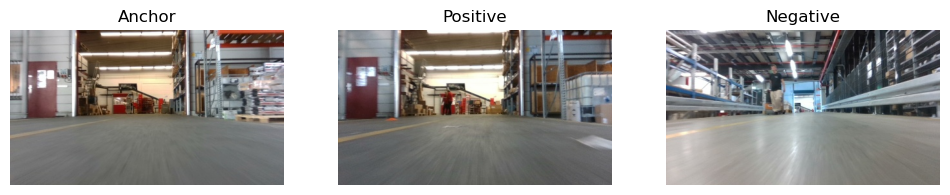

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730069_f.jpg`  
**Positive:** `task_6dc45feb-093f-47a9-a1e2-157dd6768c4d/1747979960_f.jpg`  
**Negative:** `task_64d140a3-de80-478f-9407-71f4d900a828/1747831367_f.jpg`

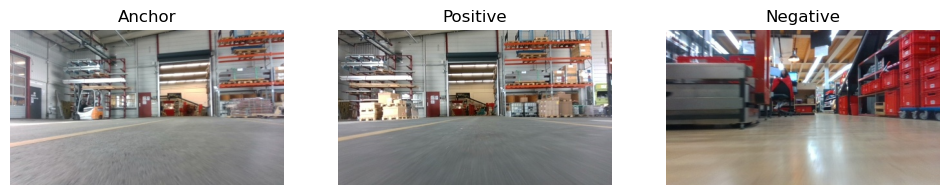

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730063_f.jpg`  
**Positive:** `task_fff1df4a-980d-49b8-a14a-47528638b305/1747989936_f.jpg`  
**Negative:** `task_786c8f69-d86e-4846-8f8b-1f9b7be73536/1747643094_f.jpg`

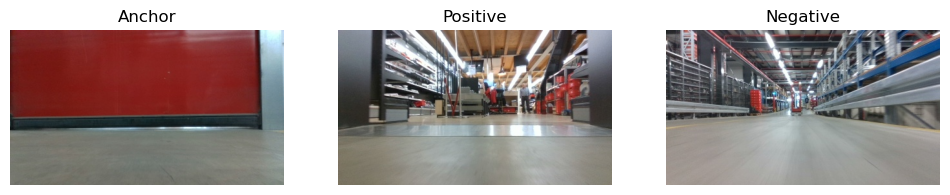

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730095_f.jpg`  
**Positive:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920124_f.jpg`  
**Negative:** `task_ea9b4a7a-b6ba-4124-ad6d-e78d165be575/1747815733_f.jpg`

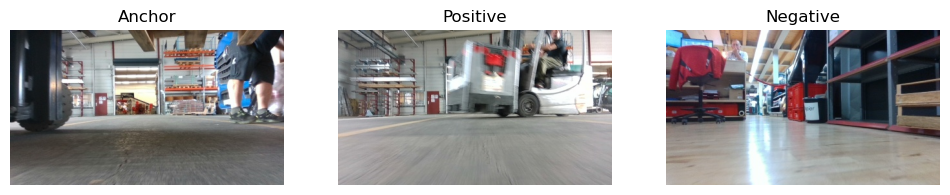

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730049_f.jpg`  
**Positive:** `task_ba87297f-b6d2-427d-9589-a67f02cf8e49/1747314596_f.jpg`  
**Negative:** `task_c4c7ab4f-bcf6-4997-88a2-9625eeef96f7/1747746704_f.jpg`

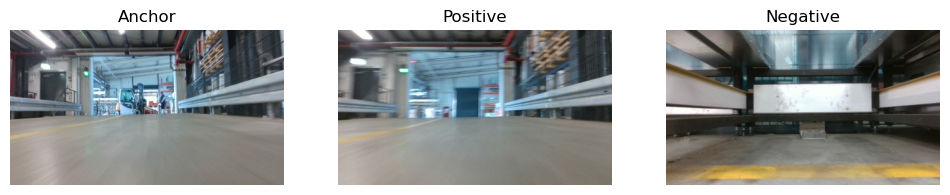

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730032_f.jpg`  
**Positive:** `task_14991870-9a9e-4734-a101-6ff8be6b3fca/1748422749_f.jpg`  
**Negative:** `task_8fd993e8-8120-432c-877b-f0b058bf8715/1748269142_f.jpg`

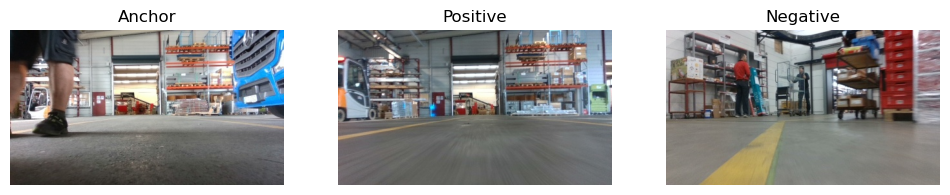

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730054_f.jpg`  
**Positive:** `task_5a60df29-58fd-41a6-a267-f3d2370cc7ec/1747817246_f.jpg`  
**Negative:** `task_379cef85-d855-4a07-b9d5-c83efd9bffb9/1747978802_f.jpg`

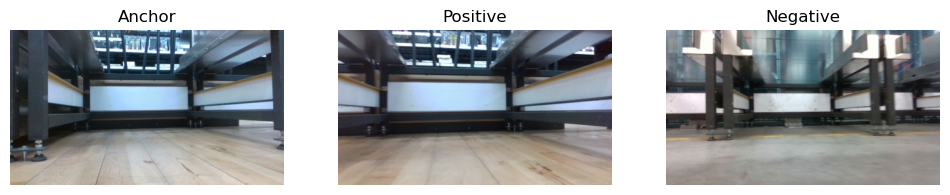

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730121_f.jpg`  
**Positive:** `task_05b27686-36e2-4dad-be86-3f6132682665/1747895959_f.jpg`  
**Negative:** `task_e11b25b2-246e-49d0-ade3-9ae6facdf7f2/1748265877_f.jpg`

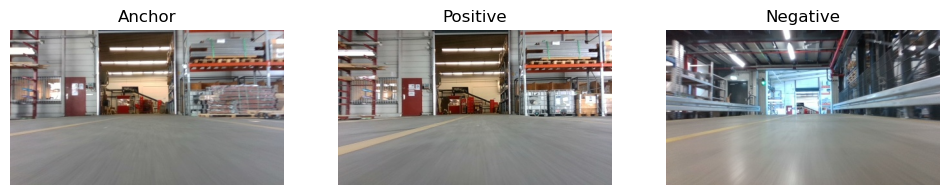

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730067_f.jpg`  
**Positive:** `task_70e2f625-aaa9-4bc8-ba95-932cc3018957/1747403263_f.jpg`  
**Negative:** `task_02823ae4-0cae-4911-bce9-416b8ef7c0a3/1747647561_f.jpg`

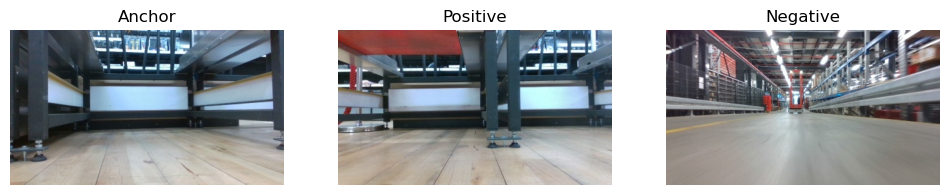

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730123_f.jpg`  
**Positive:** `task_1efbfc28-8d29-46f3-b488-d0e7cd78883b/1748000464_f.jpg`  
**Negative:** `task_bdae859f-eb26-4780-8713-982f8e48a41c/1748436853_f.jpg`

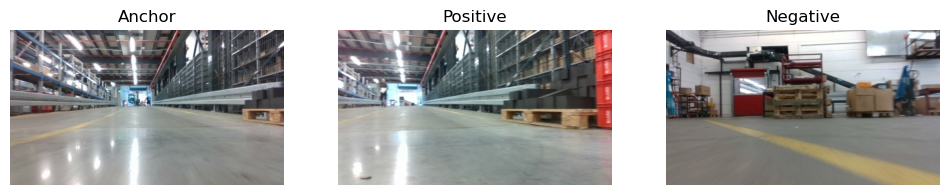

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730020_f.jpg`  
**Positive:** `task_076069b0-e4b2-4e08-8409-96409d95fe53/1747650566_f.jpg`  
**Negative:** `task_363011dc-5861-415a-b8f0-b1b397a1cc23/1748416354_f.jpg`

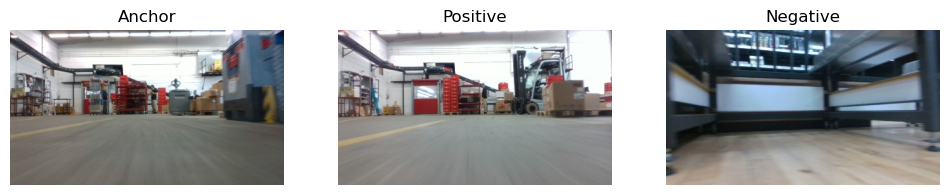

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730076_f.jpg`  
**Positive:** `task_64041a63-da77-428a-ab93-b23f567daa67/1748239680_f.jpg`  
**Negative:** `task_f436ef6e-13c1-4eaa-a6d3-60fa145b4bb0/1748348745_f.jpg`

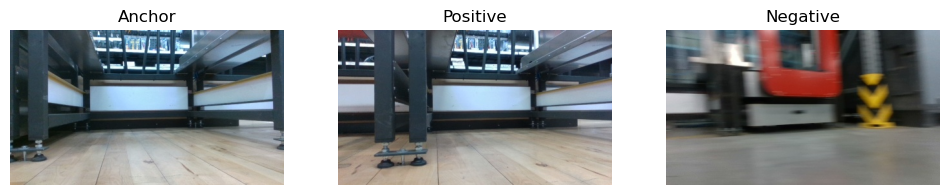

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730122_f.jpg`  
**Positive:** `task_dbfc543f-a469-4960-8120-4796e1f882e3/1748000296_f.jpg`  
**Negative:** `task_707a111d-5448-4c75-baf4-6b72dfdbe473/1747988196_f.jpg`

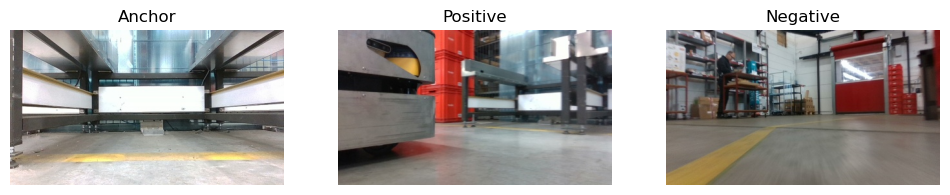

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730006_f.jpg`  
**Positive:** `task_b0286178-1c0e-4db8-af56-1a1fe5a5e8d0/1748260415_f.jpg`  
**Negative:** `task_3769d6fb-c138-488b-b636-d118395ebab7/1748262744_f.jpg`

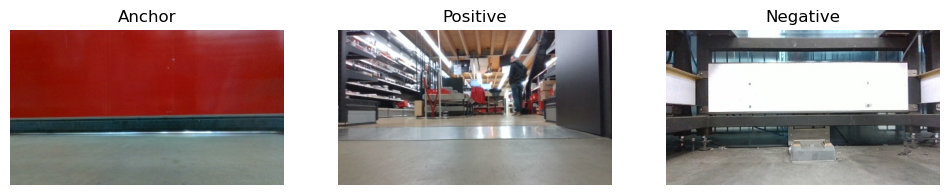

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730097_f.jpg`  
**Positive:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747910031_f.jpg`  
**Negative:** `task_c4a53065-197a-4c81-a60e-26f2b04c48e7/1747730305_f.jpg`

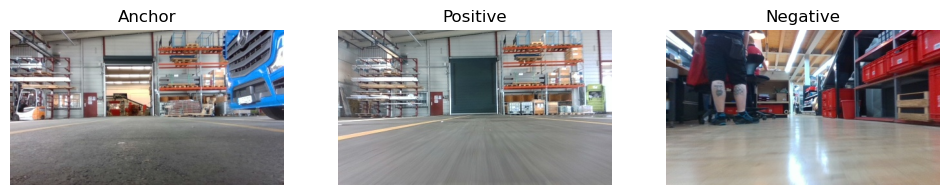

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730058_f.jpg`  
**Positive:** `task_84614c06-0a06-4a5f-be25-fbe5d0bbf68e/1748265692_f.jpg`  
**Negative:** `task_7e8a3615-246d-48bc-a2b8-a25ba98f8d50/1747641291_f.jpg`

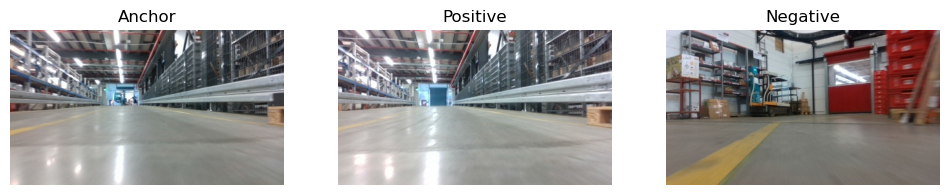

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730021_f.jpg`  
**Positive:** `task_c434042c-e37f-42d8-851b-106f9bc4683e/1748245963_f.jpg`  
**Negative:** `task_7f37c03d-d371-4dd7-9b84-b9061e1bcac1/1748264049_f.jpg`

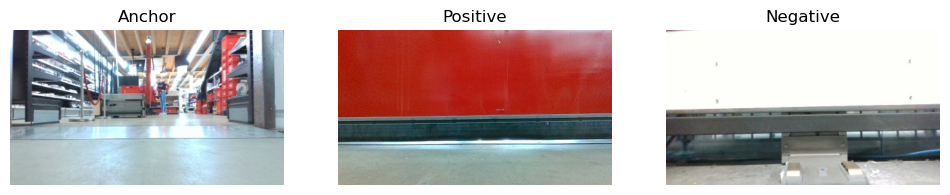

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730099_f.jpg`  
**Positive:** `task_60895b05-290c-4217-abde-3a1ef8523972/1747921895_f.jpg`  
**Negative:** `task_2b8b6961-757a-432e-b76f-0989f94c9e5e/1747661882_f.jpg`

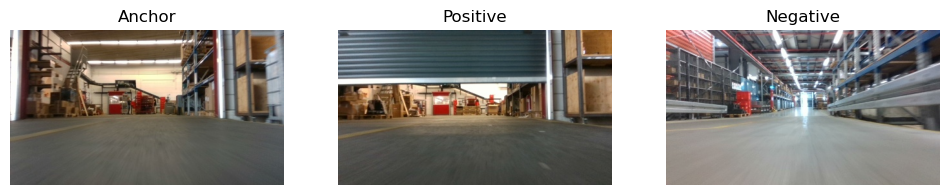

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730071_f.jpg`  
**Positive:** `task_56c7640c-7481-475e-a319-87a628be06f6/1748421852_f.jpg`  
**Negative:** `task_b34c9e77-c7e9-4c2c-8786-e2aaf0a863ff/1747655532_f.jpg`

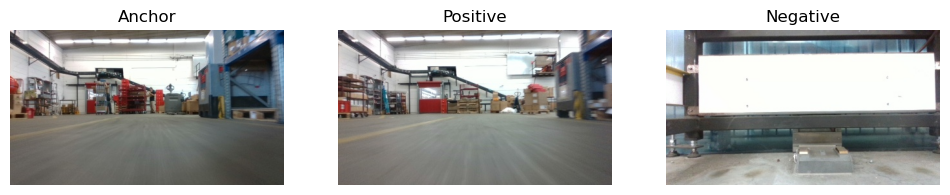

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730075_f.jpg`  
**Positive:** `task_43d6dba0-5075-496b-b413-d5c949093b2e/1748418979_f.jpg`  
**Negative:** `task_40840fba-2897-41b2-9ef4-7e60d418843a/1748339915_f.jpg`

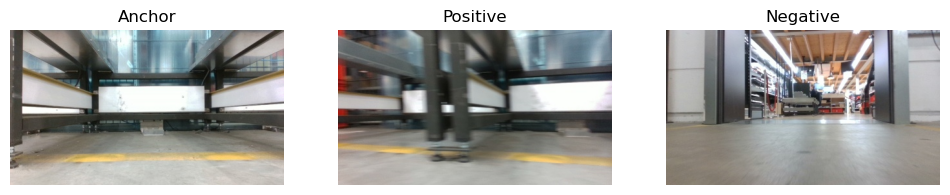

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730009_f.jpg`  
**Positive:** `task_c4086808-c63c-4f36-b355-cbcaac5635cf/1748330617_f.jpg`  
**Negative:** `task_fd87f709-2e5e-4862-bf41-d43d3fce6ccf/1748435028_f.jpg`

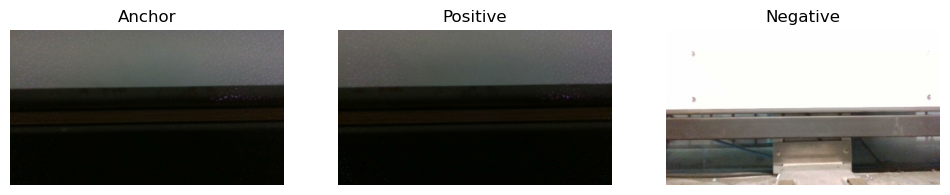

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730137_f.jpg`  
**Positive:** `task_6dc45feb-093f-47a9-a1e2-157dd6768c4d/1747980039_f.jpg`  
**Negative:** `task_6af25542-0566-4998-8b90-285f7b5299ed/1747816112_f.jpg`

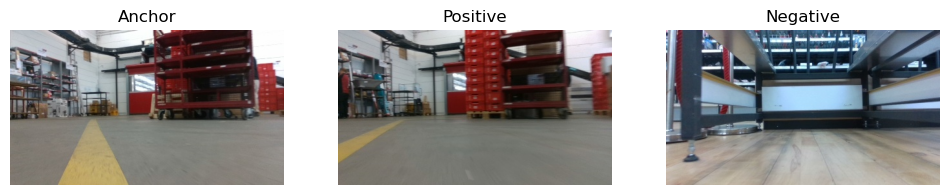

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730083_f.jpg`  
**Positive:** `task_de06c9ce-ceb0-48ab-83f4-1625528c1560/1748006438_f.jpg`  
**Negative:** `task_95837967-d232-4bdf-b8ea-3849961af5c4/1748238320_f.jpg`

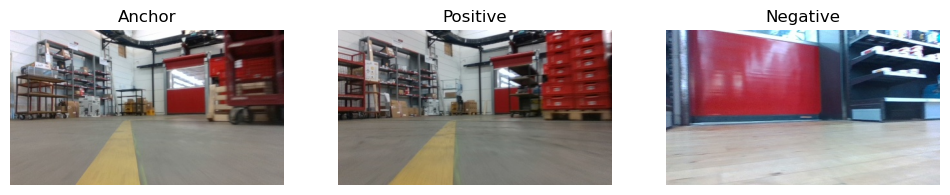

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730085_f.jpg`  
**Positive:** `task_6af25542-0566-4998-8b90-285f7b5299ed/1747816179_f.jpg`  
**Negative:** `task_45847dbe-f03c-404d-a53f-6d7efd972f18/1748006541_f.jpg`

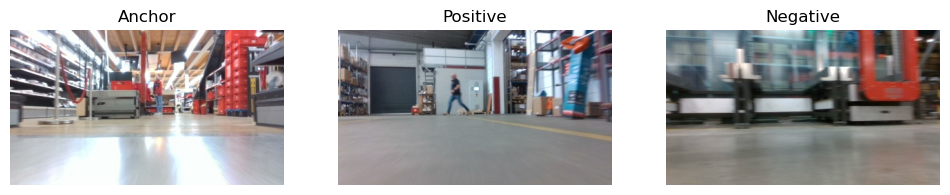

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730102_f.jpg`  
**Positive:** `task_c175c4fe-7b4c-4e64-aaf9-2b1d989114c1/1748415776_f.jpg`  
**Negative:** `task_f67166a4-25e7-496e-9f72-5ad64fe9c97a/1748242311_f.jpg`

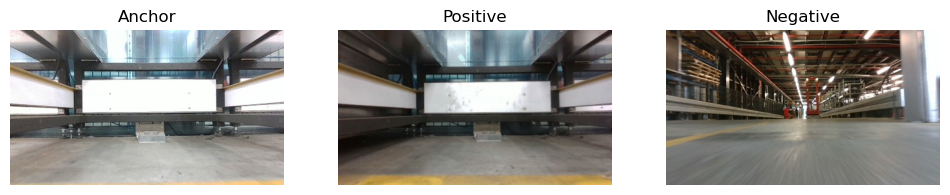

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730002_f.jpg`  
**Positive:** `task_d98958ef-b05c-473f-98ad-502413c09f71/1747740651_f.jpg`  
**Negative:** `task_6a515e27-14b7-4665-a45f-bd8a699c9ef3/1748355005_f.jpg`

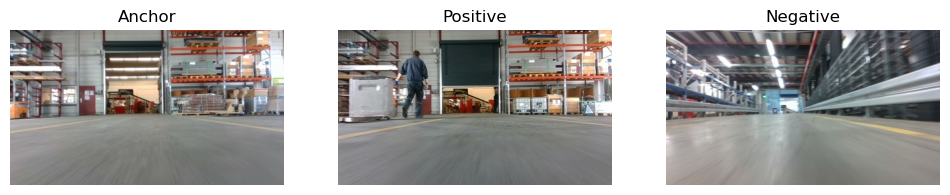

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730065_f.jpg`  
**Positive:** `task_de06c9ce-ceb0-48ab-83f4-1625528c1560/1748006418_f.jpg`  
**Negative:** `task_6cc91164-49a5-4961-9665-70d6a33d8227/1748242104_f.jpg`

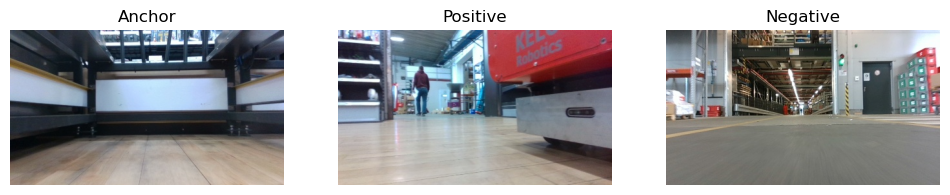

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730130_f.jpg`  
**Positive:** `task_e3057949-7c2b-4e7d-b432-df6689d67364/1748004536_f.jpg`  
**Negative:** `task_6a7de820-b261-4503-9ddb-857e4d993e7c/1747984600_f.jpg`

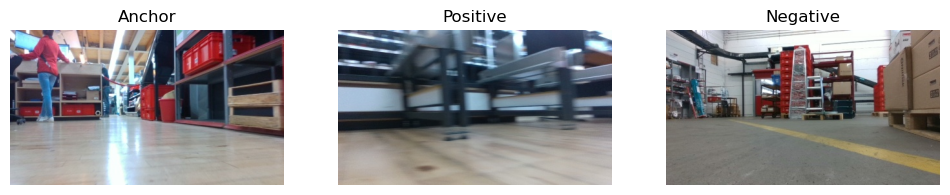

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730109_f.jpg`  
**Positive:** `task_06adb7ae-c3bf-4a9f-af05-68bad8bc3590/1747995090_f.jpg`  
**Negative:** `task_b705bb45-d18f-4a55-b91b-22e6a7ab271f/1747985605_f.jpg`

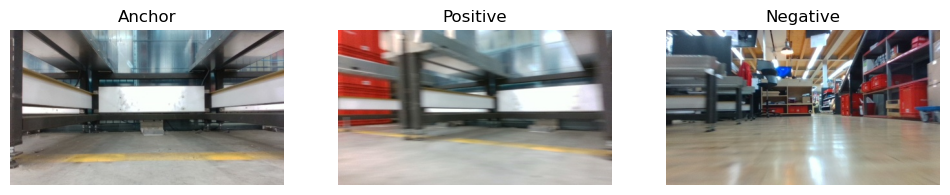

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730012_f.jpg`  
**Positive:** `task_d670a27d-ec6e-4bf7-bba4-5957b728ce6e/1748260186_f.jpg`  
**Negative:** `task_72607ac4-b749-45da-8b53-ac5d59583058/1747976467_f.jpg`

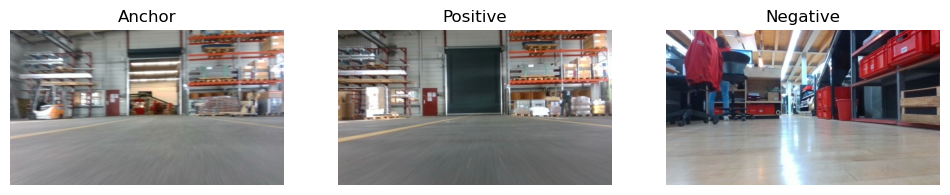

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730064_f.jpg`  
**Positive:** `task_56c7640c-7481-475e-a319-87a628be06f6/1748421845_f.jpg`  
**Negative:** `task_3d5e0085-2129-45b1-a3ff-33fde3c58a59/1747638745_f.jpg`

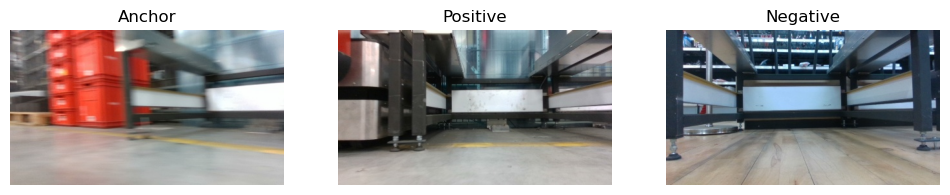

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730016_f.jpg`  
**Positive:** `task_1770a2d0-fad0-4633-9cdf-67e0105061f9/1747910199_f.jpg`  
**Negative:** `task_02823ae4-0cae-4911-bce9-416b8ef7c0a3/1747647625_f.jpg`

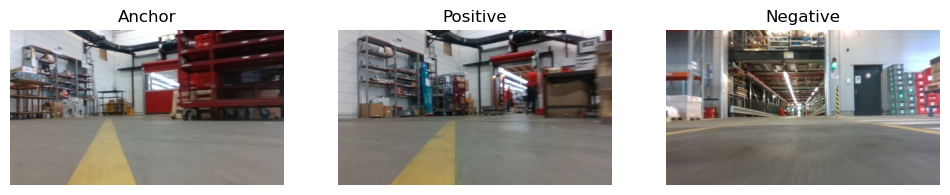

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730084_f.jpg`  
**Positive:** `task_e461bff2-b70e-4da1-bd23-f2726136f435/1748420927_f.jpg`  
**Negative:** `task_14d3ce15-666a-4783-89fc-945ea0886224/1747814735_f.jpg`

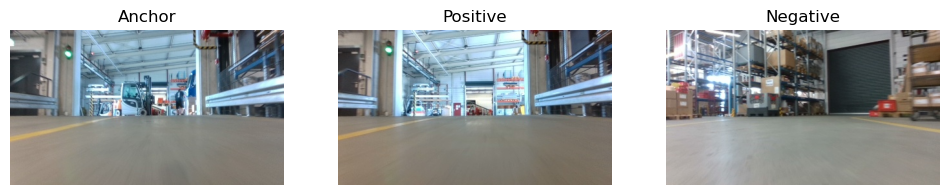

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730034_f.jpg`  
**Positive:** `task_036bcceb-37b9-47a0-902e-f90c7dc2f5da/1747651294_f.jpg`  
**Negative:** `task_88538e08-f3ed-4bb8-8b00-c254bddb9e69/1748250690_f.jpg`

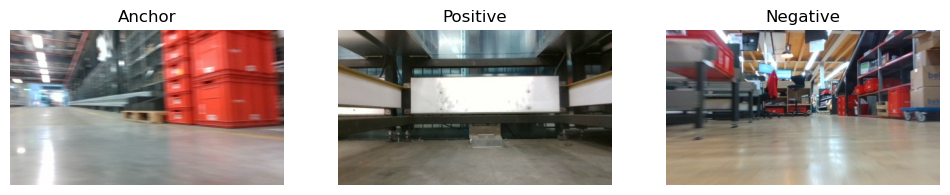

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730017_f.jpg`  
**Positive:** `task_b7610f39-7e9f-49b0-a38c-8ca17c451323/1747319453_f.jpg`  
**Negative:** `task_27edfed1-08f7-47fa-9006-70e5acc8556d/1747986593_f.jpg`

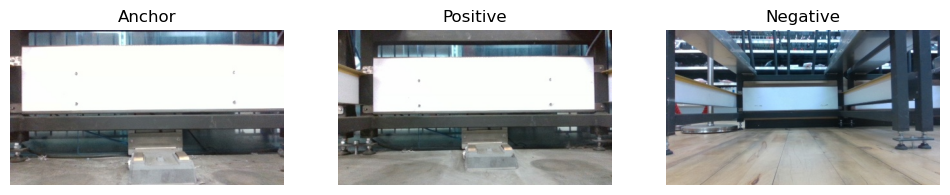

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747729997_f.jpg`  
**Positive:** `task_de06c9ce-ceb0-48ab-83f4-1625528c1560/1748006373_f.jpg`  
**Negative:** `task_6468a77d-da31-4010-af3f-b0a0fe3cc3e2/1747653780_f.jpg`

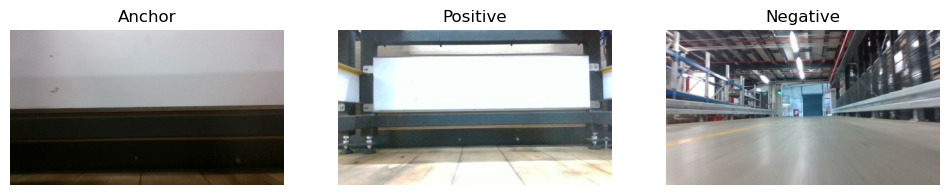

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730135_f.jpg`  
**Positive:** `task_67ffaaf4-5eca-4ddf-9bba-cb02a6822bac/1747817353_f.jpg`  
**Negative:** `task_c434042c-e37f-42d8-851b-106f9bc4683e/1748245970_f.jpg`

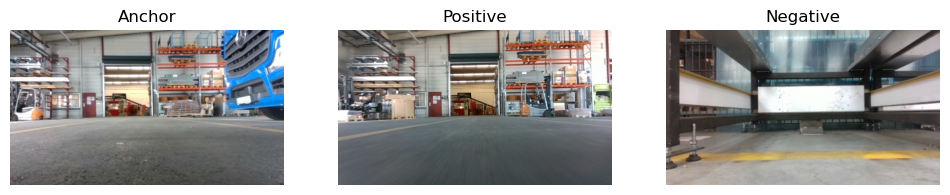

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730057_f.jpg`  
**Positive:** `task_74a69959-8c6f-45cc-ba61-562fc7653487/1747646687_f.jpg`  
**Negative:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920068_f.jpg`

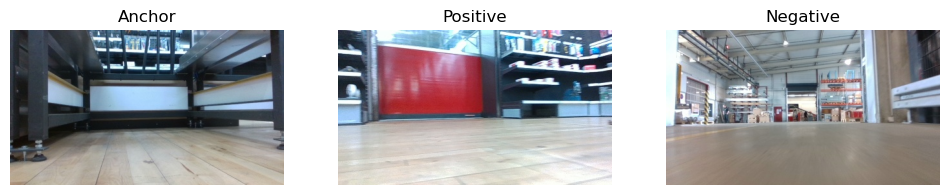

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730118_f.jpg`  
**Positive:** `task_8fd993e8-8120-432c-877b-f0b058bf8715/1748269044_f.jpg`  
**Negative:** `task_0dfe2139-b15e-4233-9797-ed84aa839a98/1747983970_f.jpg`

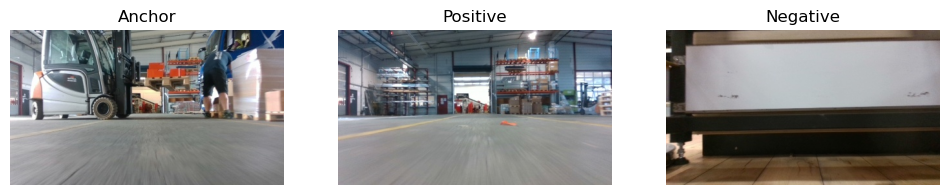

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730040_f.jpg`  
**Positive:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920095_f.jpg`  
**Negative:** `task_b1e81605-ed5d-434e-ab67-31f6a9c41393/1747999969_f.jpg`

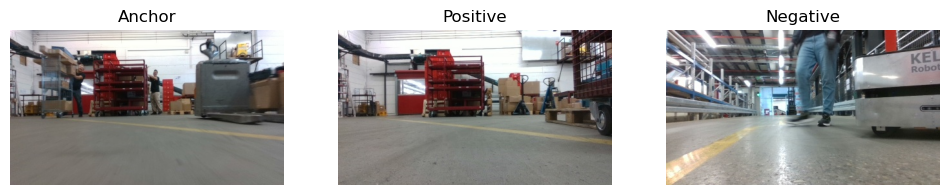

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730079_f.jpg`  
**Positive:** `task_d64ed855-eec6-48f6-9052-7740864ab548/1747718416_f.jpg`  
**Negative:** `task_c4086808-c63c-4f36-b355-cbcaac5635cf/1748330771_f.jpg`

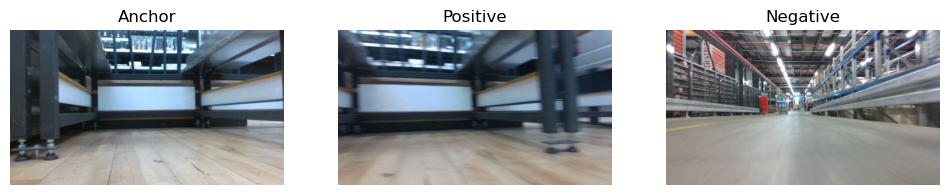

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730125_f.jpg`  
**Positive:** `task_7e8a3615-246d-48bc-a2b8-a25ba98f8d50/1747641299_f.jpg`  
**Negative:** `task_06a8f645-01a1-49f8-b19b-80993ccbed25/1748248235_f.jpg`

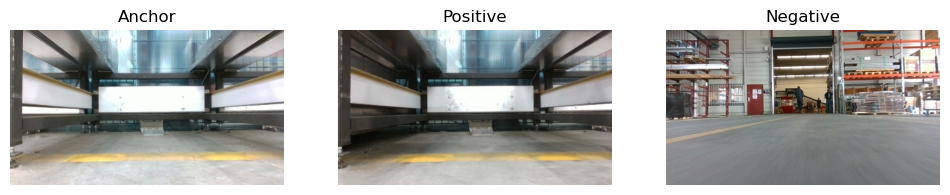

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730007_f.jpg`  
**Positive:** `task_3037d52e-157f-45ab-98f8-b681ae1d7ad0/1748439789_f.jpg`  
**Negative:** `task_c4c7ab4f-bcf6-4997-88a2-9625eeef96f7/1747746670_f.jpg`

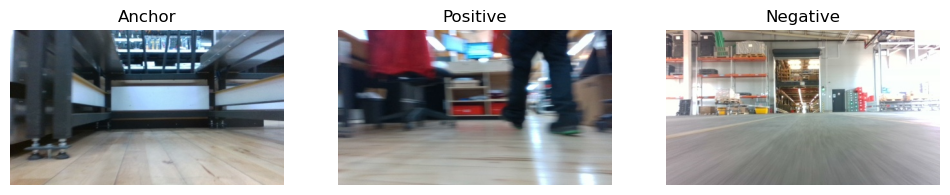

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730127_f.jpg`  
**Positive:** `task_2b8b6961-757a-432e-b76f-0989f94c9e5e/1747661973_f.jpg`  
**Negative:** `task_d3116efb-6ddf-4f68-b516-a87eaa5b0ce1/1747649445_f.jpg`

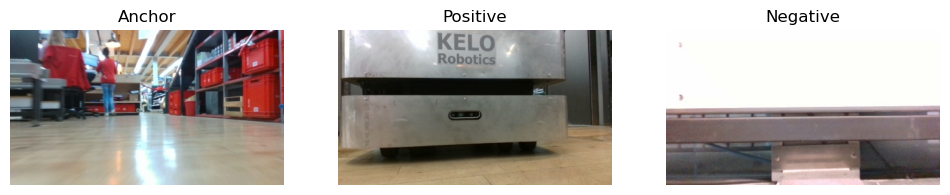

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730106_f.jpg`  
**Positive:** `task_64fed56c-8bf6-4250-a09d-1058bc06992f/1748261636_f.jpg`  
**Negative:** `task_3d5e0085-2129-45b1-a3ff-33fde3c58a59/1747638651_f.jpg`

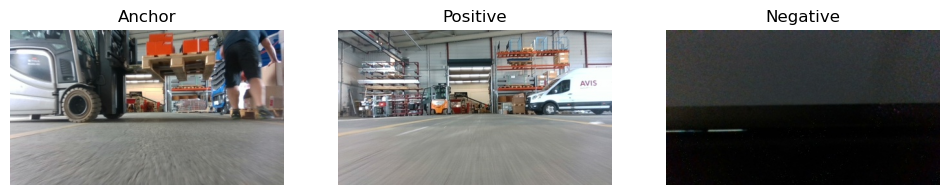

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730042_f.jpg`  
**Positive:** `task_6e7c30b5-ed1f-428e-9107-39e1f219bea7/1747982254_f.jpg`  
**Negative:** `task_0a94a4e2-5d5a-444e-b150-642302bc8805/1748265268_f.jpg`

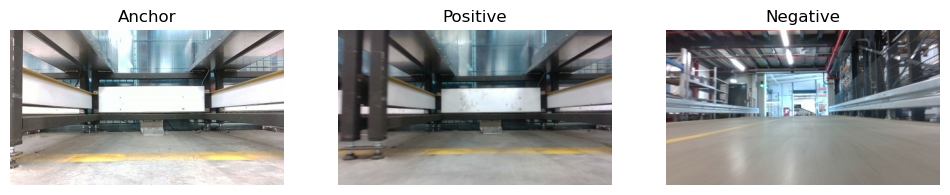

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730005_f.jpg`  
**Positive:** `task_e8f4ee48-9b32-4398-85df-8273ef04764a/1748422944_f.jpg`  
**Negative:** `task_168b310d-82a3-4a49-8d6d-73da8981aa9e/1747741992_f.jpg`

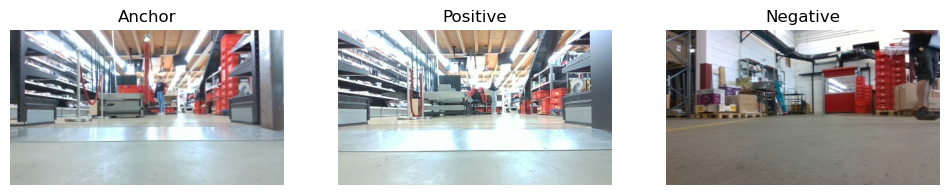

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730100_f.jpg`  
**Positive:** `task_c4086808-c63c-4f36-b355-cbcaac5635cf/1748330966_f.jpg`  
**Negative:** `task_4f42c4e4-638a-45d4-88d1-d6fc7a17d9ae/1747998323_f.jpg`

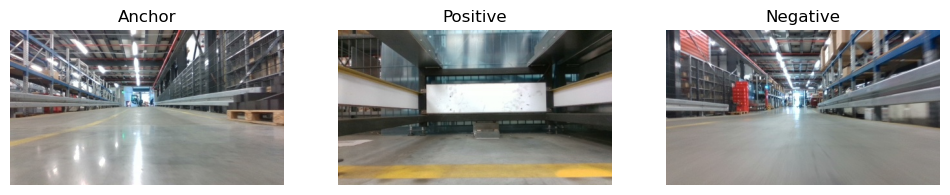

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730019_f.jpg`  
**Positive:** `task_f2844c7f-a44e-4b93-9cef-5297fc350bf7/1748000157_f.jpg`  
**Negative:** `task_cbad029f-dd3f-4c13-b88a-ed7e2ff9916d/1748265082_f.jpg`

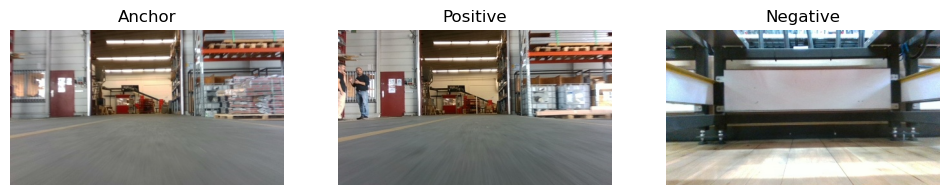

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730068_f.jpg`  
**Positive:** `task_f3504fba-c5d5-4049-877c-cc40dc25ad91/1747652618_f.jpg`  
**Negative:** `task_e11b25b2-246e-49d0-ade3-9ae6facdf7f2/1748265796_f.jpg`

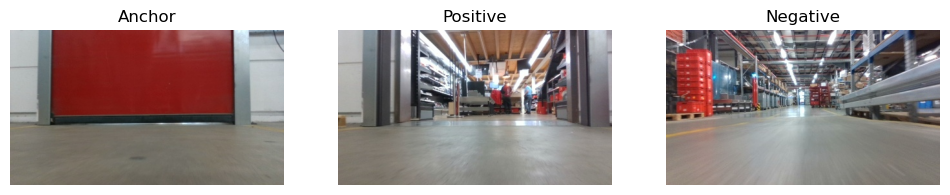

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730093_f.jpg`  
**Positive:** `task_ba87297f-b6d2-427d-9589-a67f02cf8e49/1747314626_f.jpg`  
**Negative:** `task_8bfa2ca9-bf8c-4ef0-b034-d1240ec5d5d0/1747920843_f.jpg`

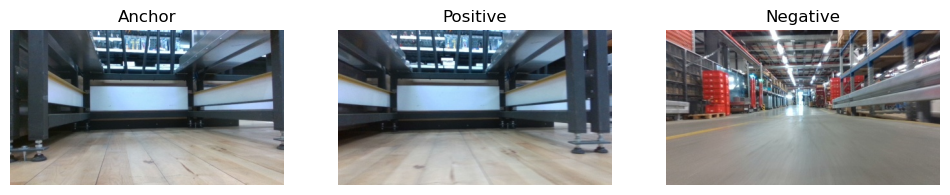

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730119_f.jpg`  
**Positive:** `task_64d140a3-de80-478f-9407-71f4d900a828/1747831461_f.jpg`  
**Negative:** `task_62b71bda-287c-4e9f-b7f6-b092eeeef72d/1748242825_f.jpg`

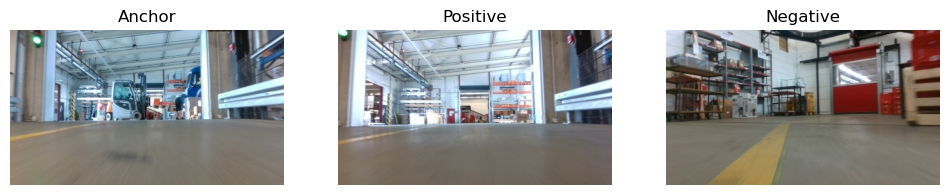

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730035_f.jpg`  
**Positive:** `task_06adb7ae-c3bf-4a9f-af05-68bad8bc3590/1747995040_f.jpg`  
**Negative:** `task_c40dff0b-1c65-4f58-ba3c-595efca479da/1747655964_f.jpg`

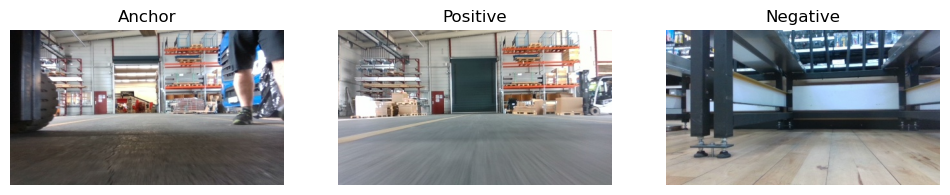

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730050_f.jpg`  
**Positive:** `task_6b967739-edd8-4484-bbb2-1d2e0b68a64f/1747998699_f.jpg`  
**Negative:** `task_9d6e8000-843a-4a20-8918-3ea9e1a2626f/1747645594_f.jpg`

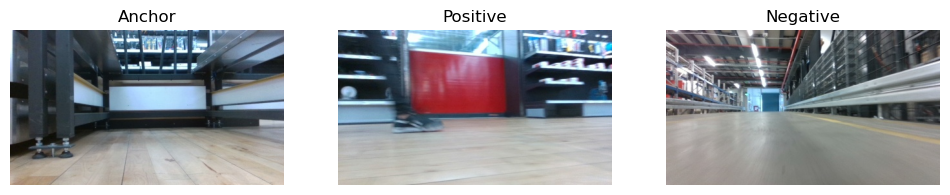

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730126_f.jpg`  
**Positive:** `task_db2aab7a-ed22-4b5d-8b7b-9bb106d77d5c/1747837924_f.jpg`  
**Negative:** `task_dbfc543f-a469-4960-8120-4796e1f882e3/1748000207_f.jpg`

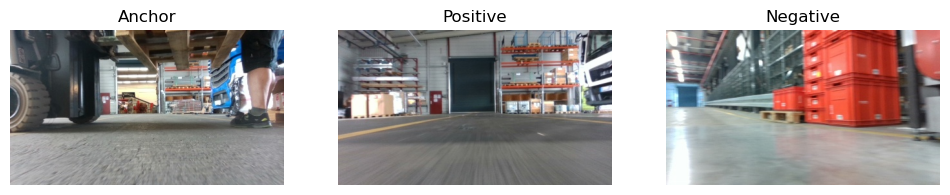

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730045_f.jpg`  
**Positive:** `task_b5e51ddd-f449-4307-b2ec-832abaf41a25/1748434536_f.jpg`  
**Negative:** `task_14991870-9a9e-4734-a101-6ff8be6b3fca/1748422733_f.jpg`

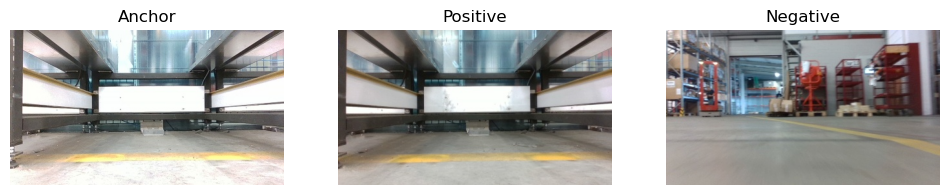

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730004_f.jpg`  
**Positive:** `task_73684964-2394-431f-a3c9-50161e483d95/1747820982_f.jpg`  
**Negative:** `task_9a8d6a35-3f78-45e5-b458-bf724219bf62/1747897697_f.jpg`

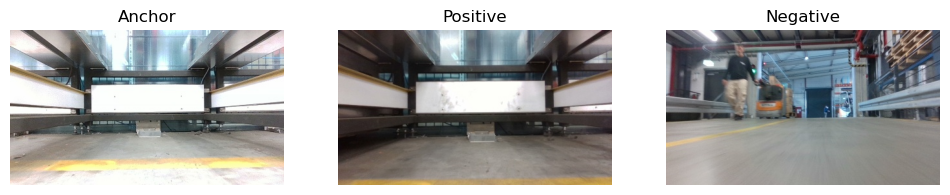

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730003_f.jpg`  
**Positive:** `task_c03f3407-35ef-4f40-a376-0e38287fa9b8/1747406216_f.jpg`  
**Negative:** `task_d670a27d-ec6e-4bf7-bba4-5957b728ce6e/1748260205_f.jpg`

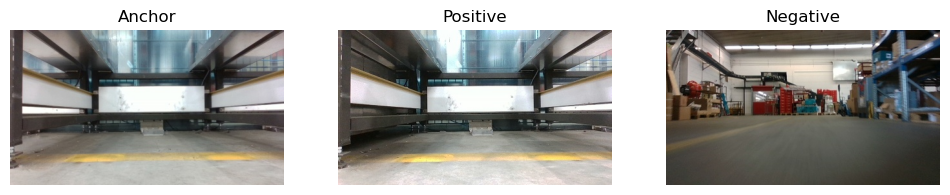

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730011_f.jpg`  
**Positive:** `task_3037d52e-157f-45ab-98f8-b681ae1d7ad0/1748439786_f.jpg`  
**Negative:** `task_fff1df4a-980d-49b8-a14a-47528638b305/1747989946_f.jpg`

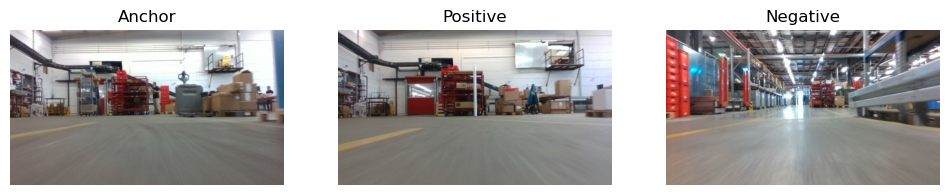

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730077_f.jpg`  
**Positive:** `task_076069b0-e4b2-4e08-8409-96409d95fe53/1747650605_f.jpg`  
**Negative:** `task_1770a2d0-fad0-4633-9cdf-67e0105061f9/1747910177_f.jpg`

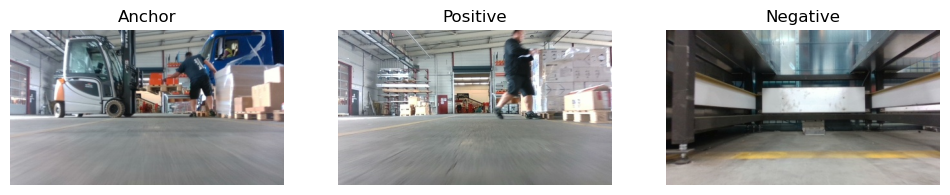

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730039_f.jpg`  
**Positive:** `task_fff1df4a-980d-49b8-a14a-47528638b305/1747989929_f.jpg`  
**Negative:** `task_1efbfc28-8d29-46f3-b488-d0e7cd78883b/1748000545_f.jpg`

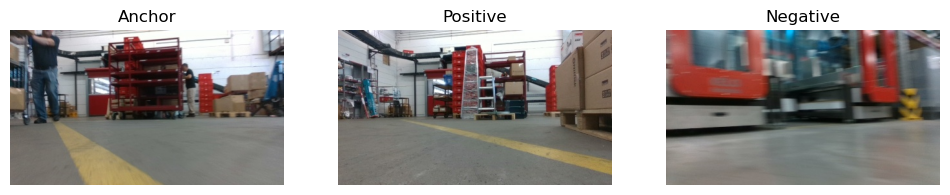

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730081_f.jpg`  
**Positive:** `task_b705bb45-d18f-4a55-b91b-22e6a7ab271f/1747985580_f.jpg`  
**Negative:** `task_7e5af180-47b3-4b11-9fcc-a6cd1acc8ead/1747922798_f.jpg`

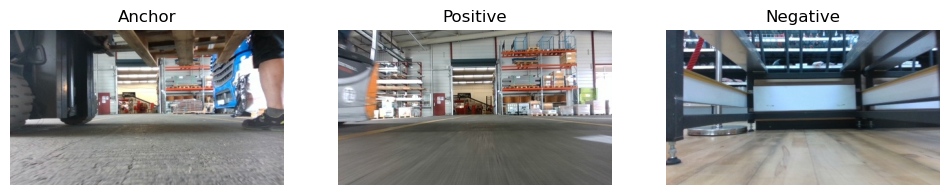

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730046_f.jpg`  
**Positive:** `task_c4086808-c63c-4f36-b355-cbcaac5635cf/1748330922_f.jpg`  
**Negative:** `task_73684964-2394-431f-a3c9-50161e483d95/1747821069_f.jpg`

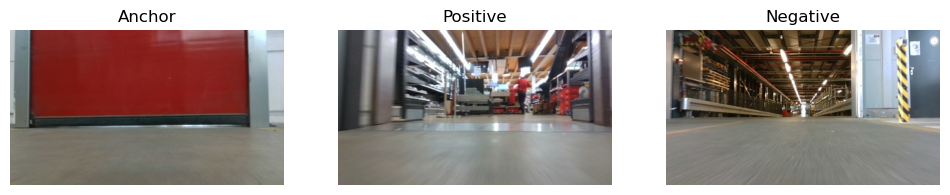

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730094_f.jpg`  
**Positive:** `task_6468a77d-da31-4010-af3f-b0a0fe3cc3e2/1747653763_f.jpg`  
**Negative:** `task_9b5a824a-262b-498a-8edf-1e45e9c8feae/1747654591_f.jpg`

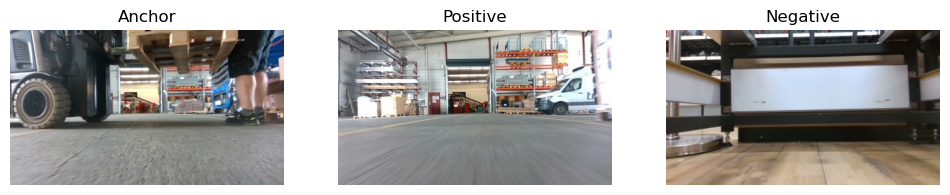

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730044_f.jpg`  
**Positive:** `task_ef955307-ed2a-426c-b0ee-84a27effeb1c/1747990888_f.jpg`  
**Negative:** `task_a86670e0-8a5f-4ab9-acff-b83c5174603b/1748245749_f.jpg`

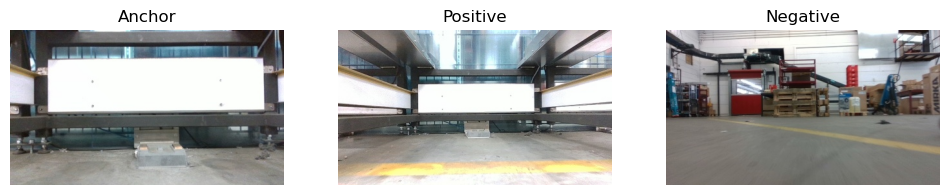

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747729999_f.jpg`  
**Positive:** `task_d43b6e7e-da81-4542-a14e-34e3f27503c1/1747724775_f.jpg`  
**Negative:** `task_14991870-9a9e-4734-a101-6ff8be6b3fca/1748422780_f.jpg`

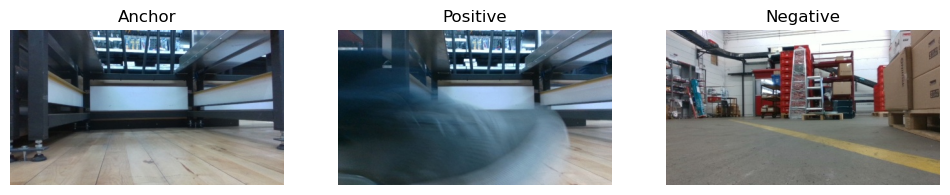

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730116_f.jpg`  
**Positive:** `task_379cef85-d855-4a07-b9d5-c83efd9bffb9/1747978868_f.jpg`  
**Negative:** `task_b705bb45-d18f-4a55-b91b-22e6a7ab271f/1747985586_f.jpg`

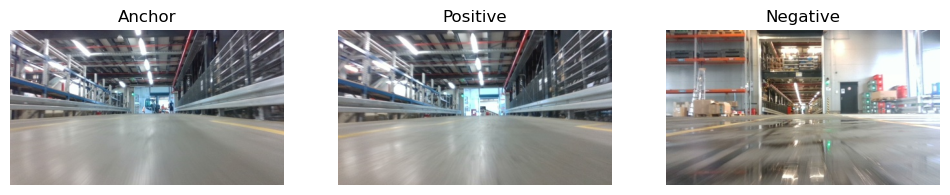

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730025_f.jpg`  
**Positive:** `task_dd6c39e0-9f92-4c94-8f0b-99315685027a/1747647289_f.jpg`  
**Negative:** `task_7e5af180-47b3-4b11-9fcc-a6cd1acc8ead/1747922767_f.jpg`

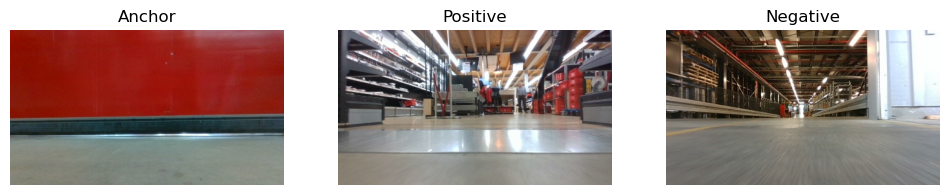

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730098_f.jpg`  
**Positive:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920125_f.jpg`  
**Negative:** `task_1efc9fcb-05a3-49e4-888d-b16588a2e08c/1747987134_f.jpg`

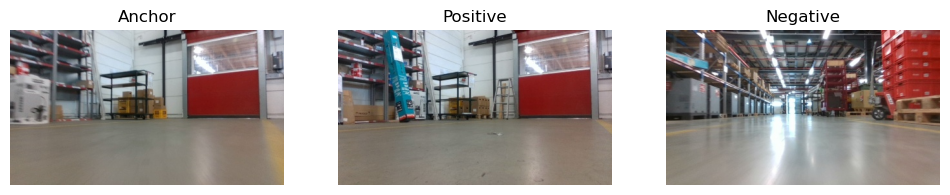

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730088_f.jpg`  
**Positive:** `task_64d140a3-de80-478f-9407-71f4d900a828/1747831416_f.jpg`  
**Negative:** `task_7ef2db10-d981-47b9-8c1f-c582ccce45f3/1748243684_f.jpg`

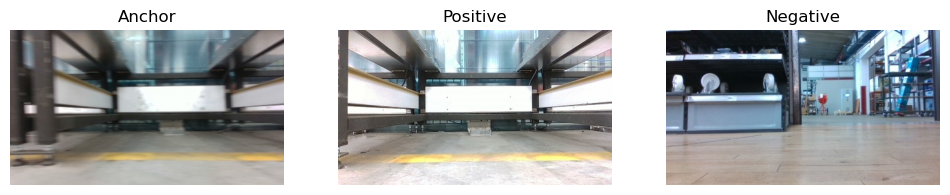

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730014_f.jpg`  
**Positive:** `task_c9af2340-fb7c-430d-9f5c-a496f69e7cd7/1748345685_f.jpg`  
**Negative:** `task_6b000d32-45e5-4b31-9e02-491cef99b174/1747991015_f.jpg`

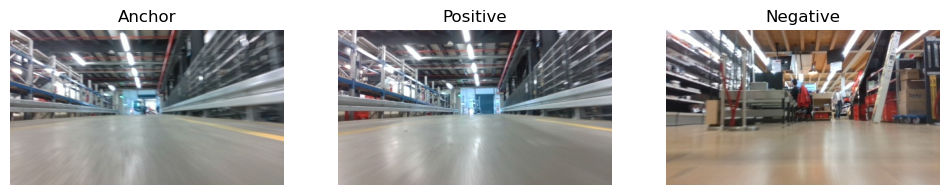

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730024_f.jpg`  
**Positive:** `task_0af58500-c027-4bc9-8327-b3dd05ee9deb/1748347044_f.jpg`  
**Negative:** `task_4f42c4e4-638a-45d4-88d1-d6fc7a17d9ae/1747998350_f.jpg`

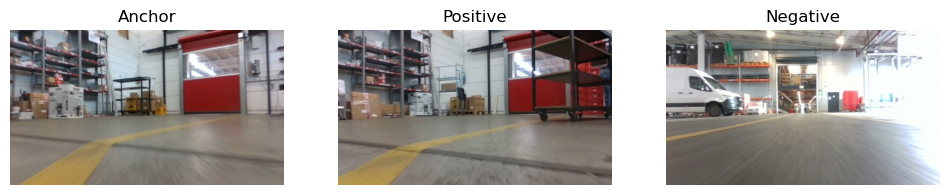

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730087_f.jpg`  
**Positive:** `task_97f7caa8-e8d1-45b7-b9ad-ab214ace84e3/1747814569_f.jpg`  
**Negative:** `task_89d6ab77-24e1-4da0-bbc7-a96518d29ffc/1748249961_f.jpg`

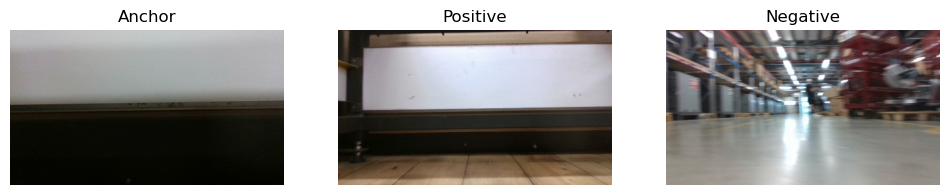

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730136_f.jpg`  
**Positive:** `task_4427a1df-777f-4924-968b-14f34d11b9a4/1748417998_f.jpg`  
**Negative:** `task_bdae859f-eb26-4780-8713-982f8e48a41c/1748436872_f.jpg`

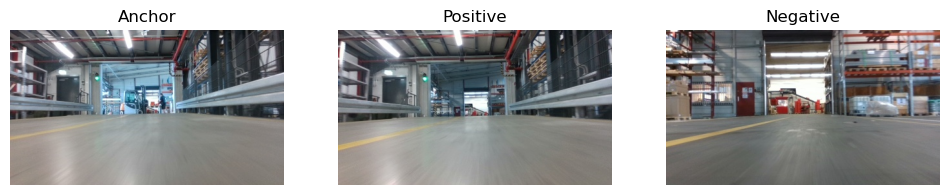

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730031_f.jpg`  
**Positive:** `task_ec6681bb-b7a2-478b-a981-2248abef4d9b/1747920087_f.jpg`  
**Negative:** `task_a57a5f84-26d7-45a5-83e0-5201f21106d2/1747919544_f.jpg`

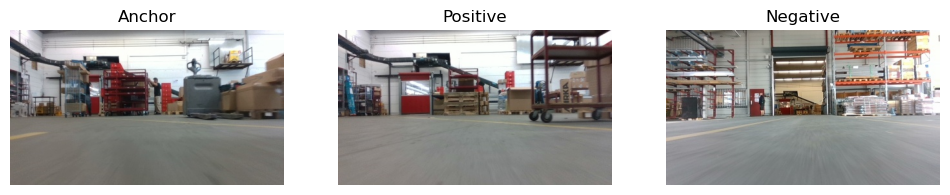

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730078_f.jpg`  
**Positive:** `task_56c7640c-7481-475e-a319-87a628be06f6/1748421864_f.jpg`  
**Negative:** `task_168b310d-82a3-4a49-8d6d-73da8981aa9e/1747742005_f.jpg`

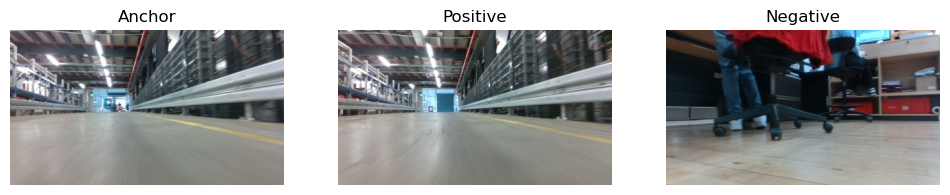

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730023_f.jpg`  
**Positive:** `task_84614c06-0a06-4a5f-be25-fbe5d0bbf68e/1748265673_f.jpg`  
**Negative:** `task_05b27686-36e2-4dad-be86-3f6132682665/1747895907_f.jpg`

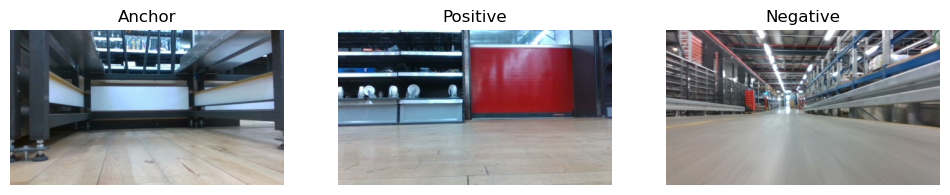

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730124_f.jpg`  
**Positive:** `task_db2aab7a-ed22-4b5d-8b7b-9bb106d77d5c/1747837930_f.jpg`  
**Negative:** `task_db2aab7a-ed22-4b5d-8b7b-9bb106d77d5c/1747837995_f.jpg`

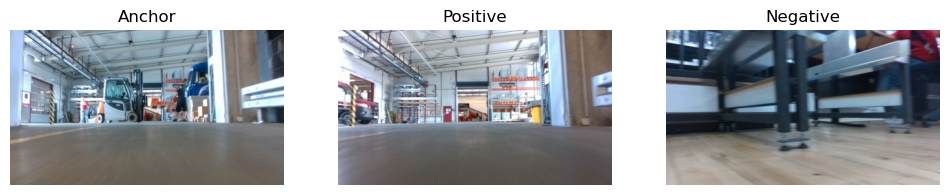

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730036_f.jpg`  
**Positive:** `task_6468a77d-da31-4010-af3f-b0a0fe3cc3e2/1747653701_f.jpg`  
**Negative:** `task_64d140a3-de80-478f-9407-71f4d900a828/1747831444_f.jpg`

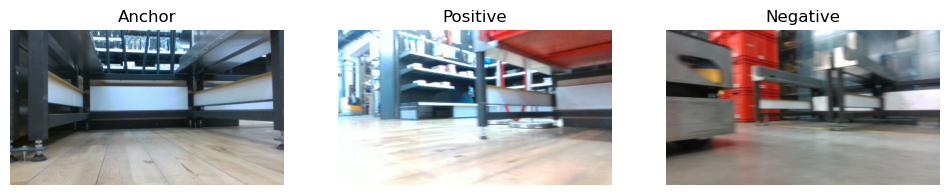

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730120_f.jpg`  
**Positive:** `task_a5f9b3a0-9c63-413d-b26f-c984440b46a9/1748347184_f.jpg`  
**Negative:** `task_49ac483e-7a5c-4f2d-8f2b-472acd0bb931/1747638901_f.jpg`

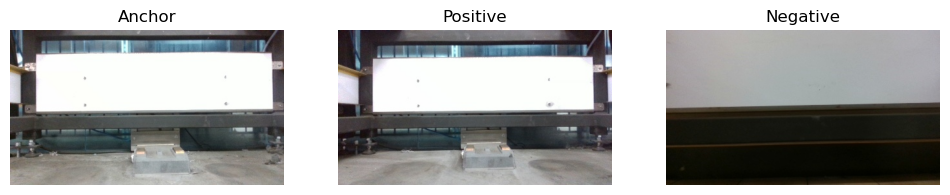

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747729998_f.jpg`  
**Positive:** `task_fd87f709-2e5e-4862-bf41-d43d3fce6ccf/1748434951_f.jpg`  
**Negative:** `task_7498a815-38db-44f2-99f4-85958d03d3d4/1748417249_f.jpg`

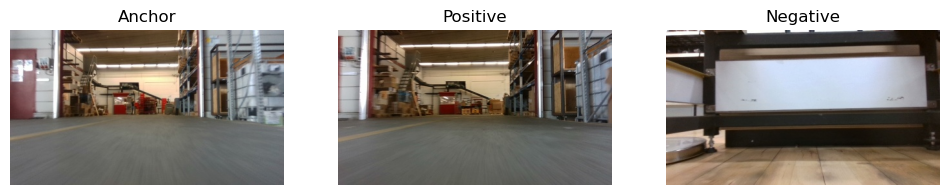

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730070_f.jpg`  
**Positive:** `task_168b310d-82a3-4a49-8d6d-73da8981aa9e/1747742011_f.jpg`  
**Negative:** `task_a95feee7-2661-443d-8e3c-0e0326eadb01/1747913770_f.jpg`

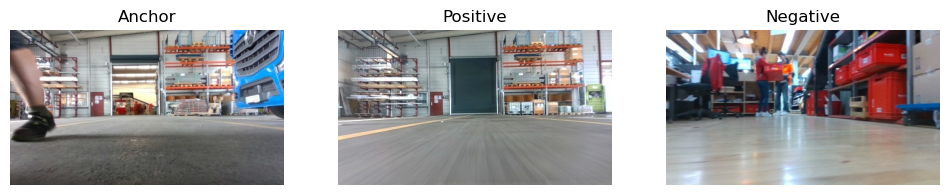

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730055_f.jpg`  
**Positive:** `task_84614c06-0a06-4a5f-be25-fbe5d0bbf68e/1748265692_f.jpg`  
**Negative:** `task_f676e5ae-1638-4d22-bf34-faccf18c6d89/1748241006_f.jpg`

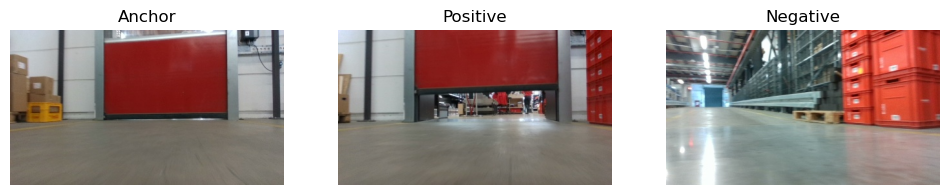

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730091_f.jpg`  
**Positive:** `task_c479dca1-a0c2-4522-977d-78fe2f58a0a1/1747987662_f.jpg`  
**Negative:** `task_488af31b-3c1a-432b-8b10-65b465e2b8e6/1747909965_f.jpg`

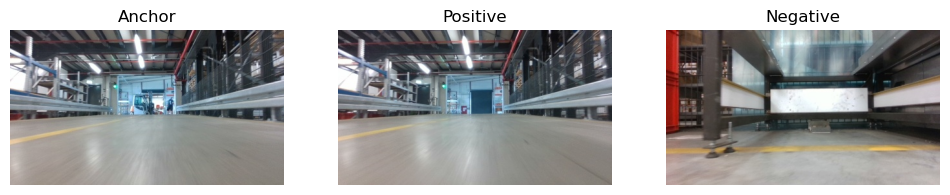

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730029_f.jpg`  
**Positive:** `task_62f522fe-67c6-40fe-83af-290f64da7db0/1748243480_f.jpg`  
**Negative:** `task_efad3d21-0f6c-46d5-a680-4b19e46692eb/1747993828_f.jpg`

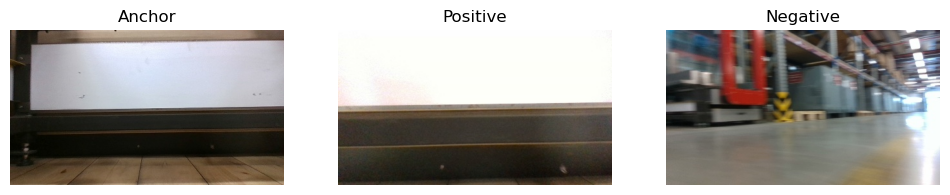

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730134_f.jpg`  
**Positive:** `task_39938472-4c47-46fa-adb6-d53b7bcad8b2/1747646769_f.jpg`  
**Negative:** `task_5de6244e-e520-46b3-8723-2e1bf21d75c8/1747641422_f.jpg`

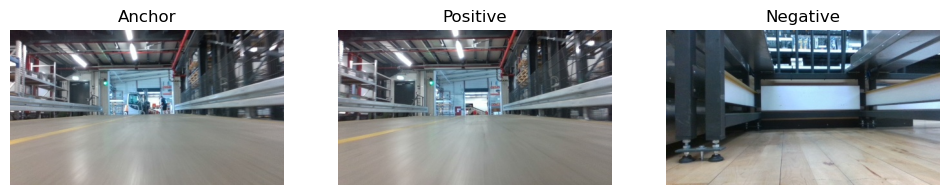

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730030_f.jpg`  
**Positive:** `task_6cc91164-49a5-4961-9665-70d6a33d8227/1748242112_f.jpg`  
**Negative:** `task_0d48733d-77c3-43c3-b87e-57ed9245d8ca/1748426881_f.jpg`

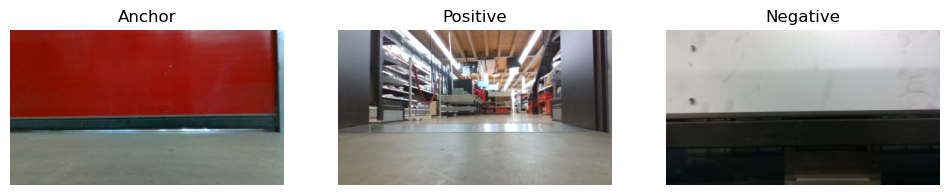

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730096_f.jpg`  
**Positive:** `task_56c7640c-7481-475e-a319-87a628be06f6/1748421879_f.jpg`  
**Negative:** `task_bfb67e98-36d4-4ef4-8902-f440c910bb27/1747980178_f.jpg`

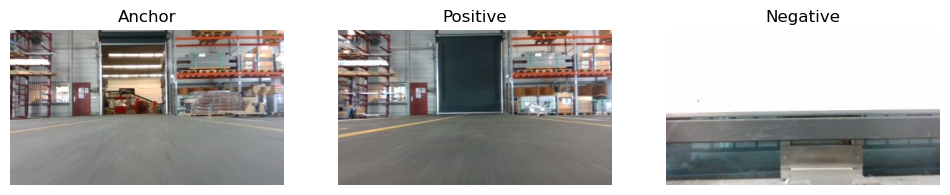

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730066_f.jpg`  
**Positive:** `task_62f522fe-67c6-40fe-83af-290f64da7db0/1748243495_f.jpg`  
**Negative:** `task_c93dee1b-f29b-4e9b-8b68-37c69e54bd2f/1748250199_f.jpg`

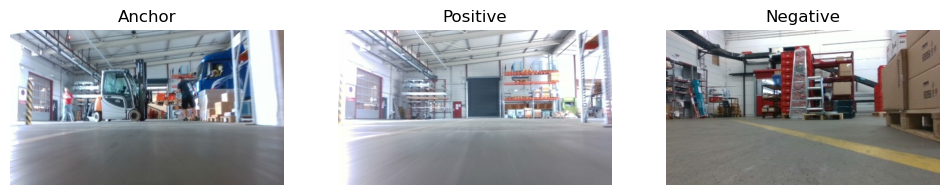

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730037_f.jpg`  
**Positive:** `task_ca76a9b5-d546-4a83-af2e-c7bb8a5f4429/1748005869_f.jpg`  
**Negative:** `task_b705bb45-d18f-4a55-b91b-22e6a7ab271f/1747985565_f.jpg`

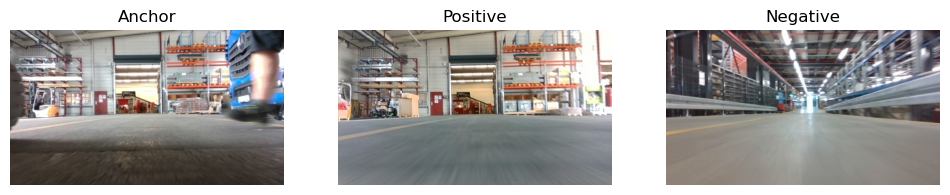

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730051_f.jpg`  
**Positive:** `task_f4129a5e-7ef7-418c-bffb-03608e43606f/1747652246_f.jpg`  
**Negative:** `task_3452e422-dec8-4d45-a653-690ce1e5d6a7/1747663927_f.jpg`

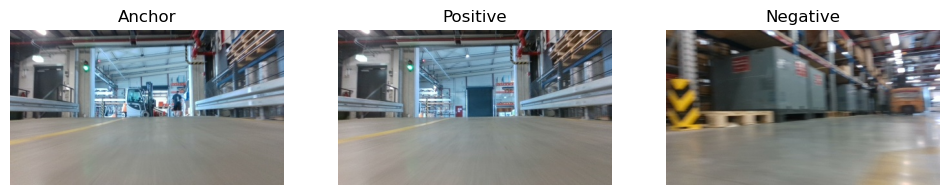

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730033_f.jpg`  
**Positive:** `task_9b70de48-7d26-42db-900d-43e1b1c55f94/1748242649_f.jpg`  
**Negative:** `task_9de408b2-64ad-4dd5-b8ef-a2290086ed1d/1747314803_f.jpg`

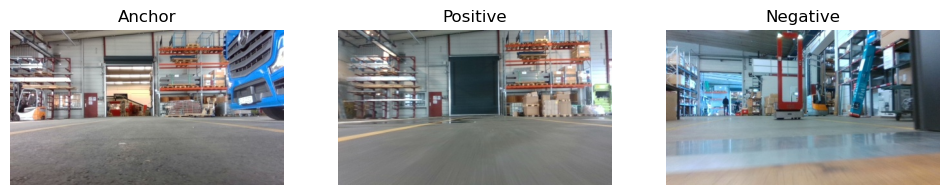

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730059_f.jpg`  
**Positive:** `task_8c3b51a8-8410-4848-b515-8c9a611efd35/1747925203_f.jpg`  
**Negative:** `task_aa7e245a-9282-4b45-be8c-a8bac7fa1c84/1748340081_f.jpg`

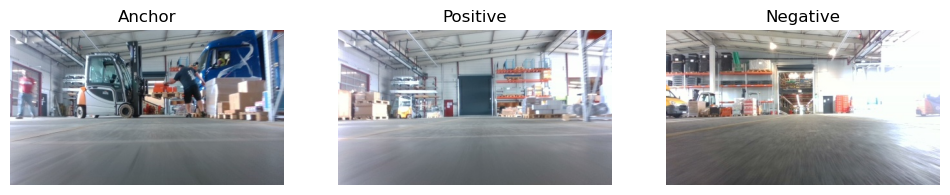

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730038_f.jpg`  
**Positive:** `task_dbfc543f-a469-4960-8120-4796e1f882e3/1748000223_f.jpg`  
**Negative:** `task_42d98ca6-9425-4e63-b7e1-0c6a620584e9/1748245861_f.jpg`

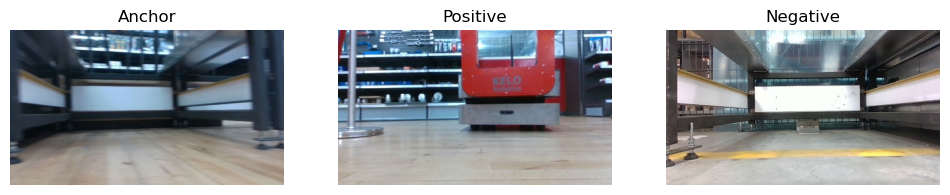

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730115_f.jpg`  
**Positive:** `task_a7571975-77c8-4756-967e-979b2344ecc6/1748419096_f.jpg`  
**Negative:** `task_ef955307-ed2a-426c-b0ee-84a27effeb1c/1747990861_f.jpg`

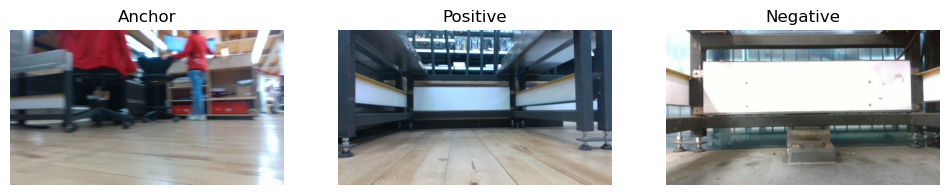

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730112_f.jpg`  
**Positive:** `task_3d5e0085-2129-45b1-a3ff-33fde3c58a59/1747638762_f.jpg`  
**Negative:** `task_a3ffa866-99d9-43d4-a10e-d2e711ed2414/1748264718_f.jpg`

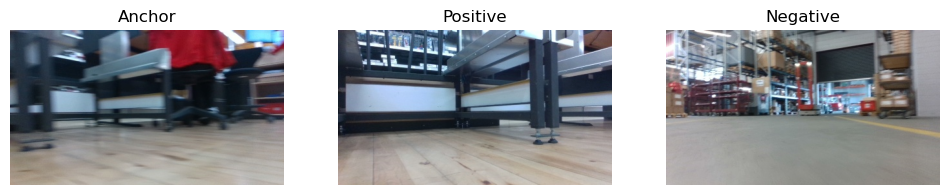

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730113_f.jpg`  
**Positive:** `task_9e56d516-da75-4a58-b4d1-1d612ce82408/1747987972_f.jpg`  
**Negative:** `task_6a515e27-14b7-4665-a45f-bd8a699c9ef3/1748354983_f.jpg`

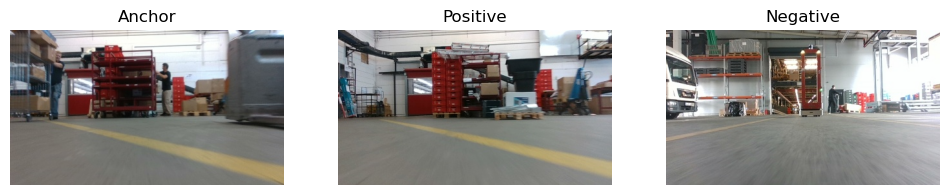

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730080_f.jpg`  
**Positive:** `task_3ff5fb5d-a693-402b-8e1d-ac5108bd5804/1747993650_f.jpg`  
**Negative:** `task_dbc98347-379f-4588-9d7d-7227aed82d31/1747730220_f.jpg`

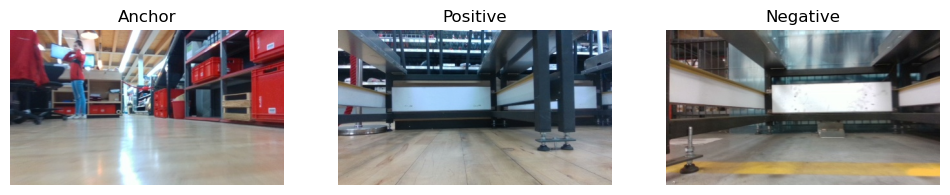

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730107_f.jpg`  
**Positive:** `task_552b4f59-0ea6-4342-abbc-68e7baefbecb/1747989131_f.jpg`  
**Negative:** `task_288d207e-9d5e-4371-a99c-076b08ab7c09/1747990156_f.jpg`

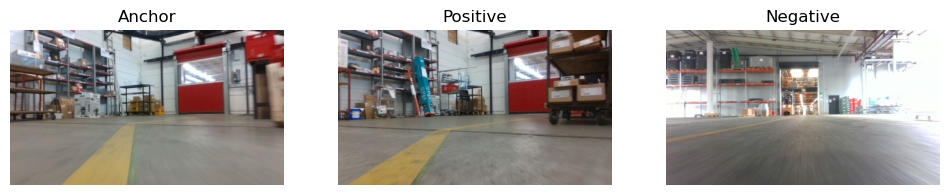

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730086_f.jpg`  
**Positive:** `task_88691d54-7c52-43f2-9017-9b00277f41c1/1747985141_f.jpg`  
**Negative:** `task_cbcf7893-3ef4-411c-9159-79b63669d502/1748421992_f.jpg`

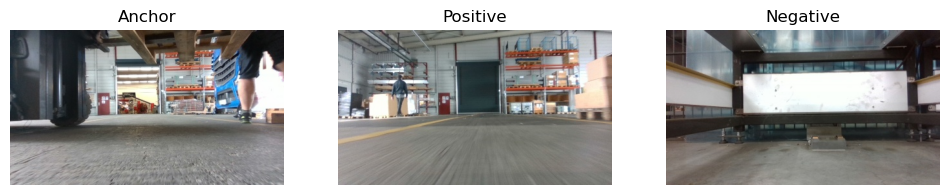

**Anchor:** `task_0211318a-66c6-42c1-a356-df572e09456a/1747730047_f.jpg`  
**Positive:** `task_87560e04-f495-44bc-96e1-b66733880f17/1748436685_f.jpg`  
**Negative:** `task_45847dbe-f03c-404d-a53f-6d7efd972f18/1748006621_f.jpg`

In [19]:
### Visualize the ground truth ***********************************************************
triplets = []
with open(gt_path, 'r') as f:
    for i, line in enumerate(f):
        if i >= 100:
            break
        anchor, positive, negative = line.strip().split()
        triplets.append((anchor, positive, negative))

for idx, (anchor, positive, negative) in enumerate(triplets):
    fig, axes = plt.subplots(1, 3, figsize=(12, 3))
    for j, img_path in enumerate([anchor, positive, negative]):
        ax = axes[j]
        full_path = os.path.join(dataset_root, img_path)
        img = mpimg.imread(full_path)
        ax.imshow(img)
        ax.axis('off')
        if j == 0:
            ax.set_title("Anchor")
        elif j == 1:
            ax.set_title("Positive")
        else:
            ax.set_title("Negative")
    plt.show()

    display(Markdown(
        f"**Anchor:** `{anchor}`  \n"
        f"**Positive:** `{positive}`  \n"
        f"**Negative:** `{negative}`"
    ))